# Spectacle de drones

<img src="images/drone_boat.png"/>

# Drone show

<img src="images/drone_boat.png"/>

Le but est de faire un joli spectacle nocturne. Dans notre cas, on a des drones avec laser qui dessinent des rectangles par groupe de 4 drones (cf ci-dessous).

On a un ensemble de 100 drones qui forment l'image d'un bateau en 3D. Pour nous il s'agit d'un ensemble de points 3D (centre de gravité de chaque drone) qu'on range dans un tableau Numpy 3 par N.

Initialement 

* l'ensemble des drones est centré en (0,0,0) donc si on veut positionner le bateau en (10, 20, 200) il faut faire une translation d'autant sur l'ensemble des drones.
* l'axe principal du bateau est l'axe de x c.a.d que l'avant du bateau est en x=6 et l'arrière en x=-6.

The goal is to make a nice night show. In our case, the drone have lasers which allow to plot rectangle surfaces (see below).

We have a set of 100 drones that form the image of a boat in 3D. For us it is a set of 3D points (center of gravity of each drone) that we store in a Numpy 3 by N table.

Initially

*all the drones are centered at (0,0,0) so if you want to position the boat at (10, 20, 200) you have to translate the same amount over all the drones.* the main axis of the boat is the axis of x i.e. the front of the boat is at x=6 and the back at x=-6.

[[-6.000e+00 -6.000e+00 -6.000e+00 -6.000e+00 -6.000e+00]
 [-1.995e+00 -9.975e-01  0.000e+00  9.975e-01  1.995e+00]
 [ 2.000e+00  5.005e-01  6.709e-04  5.005e-01  2.000e+00]]


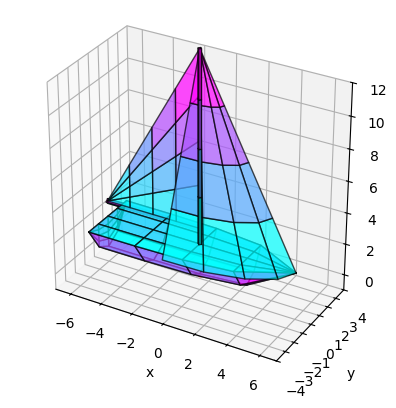

In [1]:
import numpy as np
import matplotlib.pylab as plt

np.set_printoptions(precision=3)
                 
boat = np.load('data/boat.npy')
print(boat[:,:5])

fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# Plot surfaces
def array_to_plottable(P):
    P_split = np.split(P, 7, axis=1)
    return [P_i.reshape(3, 5, 5) for P_i in P_split]

ax.scatter(xs=[0], ys=[0], zs=[0], s=10, c='r')
for P_i in array_to_plottable(boat):
    ax.plot_surface(P_i[0], P_i[1], P_i[2], alpha=0.7, cmap='cool', edgecolor='k')
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
ax.set_xlim(-7, 7)
ax.set_ylim(-4, 4)
ax.set_zlim(-1, 12)
ax.set_aspect('equal')
plt.show()
#ax = fig.add_subplot(projection='3d')
#ax.scatter(boat[0], boat[1], boat[2], marker='o')
#ax.view_init(elev=10, azim=70, roll=0)


On désire déplacer le bateau dans le ciel en lui faisant faire des figures (les unités utilisées sont le mètre et la seconde). Tous les mouvements sont décomposés seconde par seconde c.a.d. qu'on donne la position de tous les drones à chaque seconde (un autre programme se débrouille pour déplacer les drones à leur position suivante).

### Figure 1

Faire tourner le bateau (donc l'ensemble des drones) à l'horizontal autour du point (0,0,80) à une distance de 20 m. Il fait un tour complet en 5 minutes. 

On fera attention à ce que l'orientation du bateau suive le mouvement, c.a.d. que l'avant du bateau soit toujours bien orientée. 


We want to move the boat in the sky by making it do figures (the units used are the meter and the second). All movements are broken down second by second i.e. we give the position of all the drones every second (another program manages to move the drones to their next position).

### Figure 1

Rotate the boat (therefore all the drones) horizontally around the point (0,0,80) at a distance of 20 m. It makes a full turn in 5 minutes.

Care should be taken that the orientation of the boat follows the movement, i.e. that the front of the boat is always well oriented.

In [2]:

def circle(boat, t):
    

SyntaxError: incomplete input (2105917370.py, line 2)

In [2]:
def rotz(t: float):
    angle = 2*np.pi/300*t
    s = np.sin(angle)
    c = np.cos(angle)
    # There is nothing said about CW or CCW
    # so you can also flip the signs of the sinus
    return np.array([[c, s,  0], 
                     [-s,  c,  0], 
                     [0,  0,  1]])

# The full solution is to translate than to rotate:

def circle(boat: np.array, t: float) -> np.array:
    boat += np.array([[0., 20., 80.]]).T # ship start at an altitude of 80 and at 100m from (0,0)
    return rotz(t) @ boat

# Another solution faster is to start with the ship at its right place

boat_start = boat + np.array([[0., 20., 80.]]).T

def circle(boat: np.array, t: float) -> np.array:
    return rotz(t) @ boat

In [3]:
# Code to display
# Do not touch this unless you know what you are doing
import matplotlib.animation
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.transforms import Affine2D
import mpl_toolkits.mplot3d.art3d as art3d
matplotlib.rcParams['animation.embed_limit'] = 256 # 256mb max animation size

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 100  
plt.ioff()
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# 5min -> 300 sec;
FRAMEPERSEC = 0.2

def animate(t, frampersec=0.2):
    boat_prime = circle(boat_start, t/FRAMEPERSEC)
    plt.cla()
    p = Circle((0, 0), 20, fill=False)
    ax.add_patch(p)
    art3d.pathpatch_2d_to_3d(p, z=80, zdir="z")
    # Plot surface as several meshes
    for P_i in array_to_plottable(boat_prime):
        ax.plot_surface(P_i[0], P_i[1], P_i[2], alpha=0.7, cmap='cool', edgecolor='k')   
    # plt.plot(boat_prime[0,:], boat_prime[1,:], boat_prime[2,:], '.b')
    ax.set_xlim([-30, 30])
    ax.set_ylim([-30, 30])
    ax.set_zlim([50, 110]) # alternative
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.set_zlabel("z")
    ax.set_aspect('equal')
    ax.set_title(f"t: {t} sec")


matplotlib.animation.FuncAnimation(fig, animate, frames=int(300*FRAMEPERSEC))

### Figure 2

On désire faire tourner le bateau sur son axe principal (l'axe des x) jusqu'à revenir à la position d'origine. En aviation on appelle cela faire un tonneau (rotation de 360 sur l'axe du roulis). Écrire la fonction `barrel_roll(boat, T, t)` qui retourne la position de chaque drone, à l'instant `t` si un tour complet dure `T`seconds.

### Figure 2

We want to rotate the boat on its main axis (the x axis) until it returns to the original position. In aviation, this is called a barrel roll (rotation of 360 on the roll axis). Write the `barrel_roll(boat, T, t)` function that returns the position of each drone at time `t` given that a complete roll take `T` seconds.

In [ ]:

def barrel_rool(boat, T, t):


In [4]:
def rotx(T:float, t:float) -> np.array:
    # Your code here
    angle = 2*np.pi/T*(t%T)
    s = np.sin(angle)
    c = np.cos(angle)
    # There is nothing said about CW or CCW
    # so you can also flip the signs of the sinus
    return np.array([[1.,  0.,  0.], 
                     [0.,  c,  -s ],
                     [0.,  s,   c ]]) 
    
def barrel_roll(boat: np.array, T:float, t:float) -> np.array:
    return rotx(T, t) @ boat


In [5]:
# Code to display
# You can change this
Tcomplete = 20


fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# Do not touch this unless you know what you are doing
def animate2(t):
    boat_prime = barrel_roll(boat, Tcomplete, t)
    plt.cla()
    for P_i in array_to_plottable(boat_prime):
        ax.plot_surface(P_i[0], P_i[1], P_i[2], alpha=0.7, cmap='cool', edgecolor='k')   
    ax.set_xlim([-10, 10])
    ax.set_ylim([-10, 10])
    ax.set_zlim([-5, 15])
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.set_zlabel("z")
    ax.set_aspect('equal')
    ax.set_title(f"t: {t} sec")

# One frame per second for 2 complete rolls
matplotlib.animation.FuncAnimation(fig, animate2, frames=2*Tcomplete)

### Figure 3

Combiner les figures 1 et 2 pour que le bateau fasse un tonneau en 10 secondes toutes les 30 secondes.

### Figure 3

Combine figures 1 and 2 so that the boat rolls in 10 seconds every 30 seconds.

In [ ]:

def combined_move(boat, t):
    

In [6]:
def combined_move(boat: np.array, t:float) -> np.array:
    tperiod = t%30
    if tperiod < 10:
        return rotz(t) @ (rotx(10, tperiod) @ boat + np.array([[0, 20., 80.]]).T)
    else:
        return rotz(t) @ (boat + np.array([[0, 20., 80.]]).T)

In [7]:
# Code to display
# Do not touch this unless you know what you are doing
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

FRAMEPERSEC = 1

def animate3(t):
    boat_prime = combined_move(boat, t/FRAMEPERSEC)
    plt.cla()
    p = Circle((0, 0), 20, fill=False)
    ax.add_patch(p)
    art3d.pathpatch_2d_to_3d(p, z=80, zdir="z")
    for P_i in array_to_plottable(boat_prime):
        ax.plot_surface(P_i[0], P_i[1], P_i[2], alpha=0.7, cmap='cool', edgecolor='k')   
    ax.set_xlim([-30, 30])
    ax.set_ylim([-30, 30])
    ax.set_zlim([50, 110])
    ax.set_xlabel("x")
    ax.set_ylabel("y")
    ax.set_zlabel("z")
    ax.set_aspect('equal')
    ax.set_title(f"t: {t} sec")

# 5min -> 300 sec
matplotlib.animation.FuncAnimation(fig, animate3, frames=int(300*FRAMEPERSEC))